<a href="https://colab.research.google.com/github/TanyaS09/hw-data-science/blob/main/project_main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import requests
import pandas as pd
import numpy as np
import folium
import pickle

В этом проекте я исследую различные методы кластеризации: алгоритмы DBSCAN, KMeans, спектральную кластеризацию и другие. Мы изучим наземный московский транспорт и попробуем провести анализ маршрутов и остановок; кроме того, попробуем применить алгоритмы кластеризации к различным текстам и выделить несколько тем, которые встречались в этих текстах. 

Библиотеки, используемые в этом проекте:
* pandas – для работы с табличными данными
* numpy – для быстрой работы со списками и для математических операций
* pickle – для сохранения объектов в память
* folium – для визуализации данных на карте
* sklearn – для работы с алгоритмами кластеризации
* networkx – для работы с графами
* geopy – для вычисления расстояний между точками на сфере
* requests – для создания запросов к веб-страницам
* time – для управления временем в коде (паузы между запросами)
* beautifulsoup – для парсинга html-документа
* json, csv – для работы с данными соответствующего формата
* nltk – для работы с текстом и препроцессинга
* spacy – для лемматизации 
* wordcloud – для создания облаков слов

In [ ]:
data = pd.read_excel('public-transport-stops.xlsx')

In [ ]:
data.head()

,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,7,"«Дербеневская наб.», 3-й Дербеневский переулок...",37.655164,55.725668,3-й Дербеневский переулок,Yuzhny'j administrativny'j okrug,Danilovskij rajon,А632; А13,Дербеневская наб.,NaN,да,ГУП «Мосгортранс»,active,889076457,NaN
1,11,"«Наб. Тараса Шевченко», набережная Тараса Шевч...",37.572409,55.749444,набережная Тараса Шевченко,Zapadny'j administrativny'j okrug,rajon Dorogomilovo,А205; А91,Наб. Тараса Шевченко,NaN,да,ГУП «Мосгортранс»,active,889076459,NaN
2,12,"«Наб. Тараса Шевченко», набережная Тараса Шевч...",37.572716,55.749761,набережная Тараса Шевченко,Zapadny'j administrativny'j okrug,rajon Dorogomilovo,А91,Наб. Тараса Шевченко,NaN,да,ГУП «Мосгортранс»,active,889076460,NaN
3,27,"«ВКНЦ», 3-я Черепковская улица (27)",37.375509,55.757264,3-я Черепковская улица,Zapadny'j administrativny'j okrug,rajon Kunczevo,А798; А816; А660,ВКНЦ,NaN,да,ГУП «Мосгортранс»,active,889076461,NaN
4,33,"«Новосущевская ул.», улица Сущёвский Вал (33)",37.603376,55.792891,улица Сущёвский Вал,Severo-Vostochny'j administrativny'j okrug,rajon Mar`ina Roshha,А126; А84; А384; АТ18; АТ42,Новосущевская ул.,NaN,да,ГУП «Мосгортранс»,active,889076463,NaN


Посмотрим на распределение остановок по районам:

In [ ]:
counts = data.groupby('District_en')['ID_en'].count()
counts

District_en
Akademicheskij rajon        99
Alekseevskij rajon          64
Altuf`evskij rajon          33
Babushkinskij rajon         75
Basmanny'j rajon           140
                          ... 
rajon Yuzhnoe Tushino       94
rajon Zamoskvorech`e        59
rajon Zapadnoe Degunino     70
rajon Zyablikovo            71
rajon Zyuzino               94
Name: ID_en, Length: 146, dtype: int64

По официальным данным в Москве 125 районов и 21 поселение – всё сошлось с нашими данными

In [ ]:
counts[counts == counts.min()] # здесь меньше всего остановок

District_en
rajon Vostochny'j    3
Name: ID_en, dtype: int64

In [ ]:
counts[counts == counts.max()] # здесь больше всего остановок

District_en
rajon Yuzhnoe Butovo    197
Name: ID_en, dtype: int64

Местоположение каждой остановки описано двумя координатами – долготой и широтой. Кроме того, для каждой остановки известно, какому маршруту она принадлежит – эта информация содержится в столбце RouteNumbers_en. Попробуем вытащить эту информацию из датафрейма и представить в более удобном виде:

In [ ]:
def get_routes(data):
    '''
    Функция, предназначенная для получения словаря, где ключами являются маршруты, а значениями -- список остановок для каждого маршрута
    param data: pd.DataFrame - данные об остановках
    return: dict - e.g. routes['A1'] = [1, 3, 145]
    '''
    # в датафрейме информация о маршрутах остановки -- это строка, разбиваем её по разделителю '; '
    routes_list = [route.split('; ') for route in data['RouteNumbers_en']]
    routes_list = set(r for route in routes_list for r in route) # убираем дубликаты
    routes = {} # итоговый словарь
    for route in routes_list:
        parsed = data['RouteNumbers_en'].str.split('; ').tolist() # список маршрутов для каждой остановки
        idxs = np.where([route in query for query in parsed]) # индексы только для остановок, входящих в текущий маршрут
        routes[route] = data.iloc[idxs]['ID_en'].tolist() # получаем ID остановок и кладём в словарик
    return routes

In [ ]:
routes = get_routes(data) # функция может работать долго

In [ ]:
import pickle

# сохраняем маршруты в файл .pickle – теперь не придётся перезапускать функцию get_routes
with open('routes.pickle', 'wb') as handle:
    pickle.dump(routes, handle, protocol=pickle.HIGHEST_PROTOCOL)

Теперь для каждого маршрута у нас есть список остановок, но мы не знаем, в каком порядке они расположены. Чтобы упорядочить остановки, будем измерять расстояние между ними: для этого используем модуль geopy и метод оттуда, вычисляющий расстояния на сфере (в километрах):

In [ ]:
import geopy.distance
def calc_distance(data, stop_a, stop_b):
    '''
    Функция для подсчёта расстояния между остановками
    param data: pd.DataFrame - данные об остановках
    param stop_a, stop_b: id остановок
    '''
    a = data.loc[data['ID_en'] == stop_a]
    b = data.loc[data['ID_en'] == stop_b]
    coords_a = (a['Latitude_WGS84_en'].values[0], a['Longitude_WGS84_en'].values[0])
    coords_b = (b['Latitude_WGS84_en'].values[0], b['Longitude_WGS84_en'].values[0])
    return geopy.distance.distance(coords_a, coords_b).km

Идея следующая: если остановка конечная, она будет наиболее удалённой от остальных остановок этого маршрута (сумма расстояний от неё до всех остальных будет максимальной). Попробуем посчитать эти расстояния и отсортировать остановки для всех маршрутов (фугкция может раобтать долго):

In [ ]:
def sort_routes(data, routes):
    '''
    param data: pd.DataFrame - данные об остановках
    param routes: dict - словарь с данными о маршруте
    return: dict - отсортированные списки остановок для каждого маршрута
    '''
    '''
    Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
    Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).
    '''
    sorted_routes = {}
    for route, s in routes.items():
        if len(s) == 1:  # есть маршруты из одной остановки!
            sorted_routes[route] = [data[data['ID_en'] == s[0]].index[0]]
            continue
        stops = set(s)
        sorted_stops = []
        distances = {} # словарик для расстояний, чтобы не пересчитывать одни и те же расстояния несколько раз
        initial_stop = 0
        max_distance = 0
        for x in stops:
            for y in stops:
                key = tuple(sorted([x, y])) # сортируем, чтобы использовать кортеж как ключ в словаре
                if x != y:
                    if key not in distances.keys():
                        distances[key] = calc_distance(data, x, y) # используем функцию, объявленную выше
                else:
                    distances[key] = 0
                if distances[key] > max_distance: # обновляем значения для наиболее удалённой остановки
                    max_distance = distances[key] 
                    initial_stop = x
        sorted_stops.append(initial_stop)
        stops.remove(initial_stop)
        while stops: # пока остались остановки
            last_stop = sorted_stops[-1] # берем последнюю остановку из уже отсортированных
            distances = [(calc_distance(data, last_stop, stop), stop) for stop in stops]
            next_stop = int(min(distances)[1]) # ищем самую ближнюю остановку к последней
            stops.remove(next_stop) # эта ближняя остановка - следующая
            sorted_stops.append(next_stop) # удаляем остановку из списка
        sorted_stops = [data[data['ID_en'] == stop].index[0] for stop in sorted_stops] # возвраащаем список индексов вместо ID
        sorted_routes[route] = sorted_stops
    return sorted_routes

In [ ]:
sorted_routes = sort_routes(data, routes)

In [ ]:
# полученный словарь точно нужно сохранить через pickle -- sort_routes работает довольно долго

with open('sorted_routes.pickle', 'wb') as handle:
    pickle.dump(sorted_routes, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [ ]:
# Загрузим из памяти sorted_routes
with open('sorted_routes.pickle', 'rb') as file:
    sorted_routes = pickle.load(file)

Проверим адекватность полученных маршрутов: нарисуем их на карте. Сделаем функцию для визуализации конкретного маршрута по его названию:

In [ ]:
def visualize_route(route_name: str, m=None):
    if m is None:
        m = folium.Map([55.75215, 37.61819], zoom_start=12)
    coords = data.loc[
        sorted_routes['А' + route_name],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(m)
    return m
        
visualize_route('М3')

In [ ]:
visualize_route('М7')

Попробуем посмотреть на остановки как на граф (по сути, это и есть граф, где вершины – это остановки, а рёбра – наличие маршрута между ними). Построим по ранее полученному словарику маршрутов матрицу смежности графа остановок:

In [ ]:
def get_adjacency_matrix(data, sorted_routes):
    '''
    Функция, чтобы получить матрицу смежности по словарю маршрутов
    param data: pd.DataFrame - данные об остановках
    param sorted_routes: dict - отсортированные списки остановок для каждого маршрута
    return: (n_samples, n_samples) - матрица смежности
    '''
    stops = sorted(set(sum(sorted_routes.values(), [])))
    n_samples = len(stops)
    matrix = np.zeros((n_samples, n_samples))
    for route, route_stops in sorted_routes.items():
        for i, stop in enumerate(route_stops):
            if i > 0:
                prev_stop = route_stops[i - 1]
                matrix[stop, prev_stop] = 1
                matrix[prev_stop, stop] = 1
    return matrix

In [ ]:
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)
adjacency_matrix.shape

(11788, 11788)

In [ ]:
import networkx as nx

# Создание графа на основе матрицы смежности
graph = nx.from_numpy_matrix(adjacency_matrix)

In [ ]:
# Визуализация графа не получится, поскольку он огромный
# nx.draw(graph, with_labels=True)

In [ ]:
# Анализ свойств графа

# Количество вершин и ребер
num_nodes = graph.number_of_nodes()
num_edges = graph.number_of_edges()

# Получение списка вершин и ребер
nodes = list(graph.nodes)
edges = list(graph.edges)

# Проверка связности графа
is_connected = nx.is_connected(graph)

# Степени вершин
node_degrees = graph.degree()

In [ ]:
# Посмотрим на вершину, имеющую максимальную степень, то есть, максимальное число соседей
max_degree = 0
max_id = -1
for q in node_degrees:
    degree = q[1]
    if degree > max_degree:
        max_degree = degree
        max_id = q[0]
max_id, max_degree

(7315, 21)

In [ ]:
data.loc[7315]

ID_en                                                              10028
Name_en                 «Братиславская ул.», Братиславская улица (10028)
Longitude_WGS84_en                                             37.758613
Latitude_WGS84_en                                              55.660466
Street_en                                            Братиславская улица
AdmArea_en                      Yugo-Vostochny'j administrativny'j okrug
District_en                                                rajon Mar`ino
RouteNumbers_en        А657; А625; А10; А713; А30; А749; А762; АН5; А...
StationName_en                                         Братиславская ул.
Direction_en                                                         NaN
Pavilion_en                                                           да
OperatingOrgName_en                                    ГУП «Мосгортранс»
EntryState_en                                                     active
global_id                                          

Учитывая количество маршрутов, проходящих через эту остановку, неудивительно, что эта вершина имеет максимальное число соседей.

Теперь попробуем кластеризовать остановки. Для этого будем использовать встроенную в networkx кластеризацию, методы кластеризации DBSCAN и KMeans из sklearn, а также спектральную кластеризацию -- графовый метод, основанный на лапласиане графа и его собственных векторах

In [ ]:
# Алгоритм Лувена (Louvain)
communities = nx.algorithms.community.label_propagation_communities(graph)

# Коэффициент кластеризации
clustering_coefficient = nx.average_clustering(graph)
clustering_coefficient

0.15627009570002284

In [ ]:
len(communities)

3004

Алгоритм Лувена выделяет не кластеры, а, скорее, сообщества в графе – то есть структуры, в которых между каждой или почти каждой вершиной есть ребро. Поскольку мы соединяли рёбрами только вершины, которые являются соседями на одном маршруте, алгоритм Лувена выдал много маленьких сообществ.

Коэффициент кластеризации (clustering coefficient) является мерой, которая оценивает степень кластеризации или связности вершин в графе. Он измеряет, насколько близко связанные соседние вершины связаны друг с другом. Коэффициент кластеризации определяется для каждой вершины графа и вычисляется как отношение количества ребер между соседними вершинами к максимально возможному количеству ребер между ними. Это показывает, насколько вершины в графе склонны образовывать группы или кластеры.

Значение коэффициента кластеризации может варьироваться от 0 до 1. Значение 1 означает, что все соседние вершины графа полностью связаны друг с другом, а значение 0 означает, что нет связей между соседними вершинами.

Коэффициент кластеризации может быть использован для изучения структуры графа, выявления плотных кластеров и оценки степени кластеризации вершин. Он также может помочь в анализе социальных сетей, где кластеризация вершин может указывать на группы или сообщества пользователей с тесными связями.

Мы получили небольшое значение коэффициента кластеризации – в целом, это ожидаемо, ведь ребро мы проводили только между соседними вершинами для маршрутов.

In [ ]:
from sklearn.cluster import DBSCAN, KMeans

In [ ]:
def draw_map(data, labels):
    '''
    Создаём folium-карту с разными кластерами остановок
    param data: pd.DataFrame - данные об остановках
    param labels: (n_samples, ) - лейбл кластера для каждой остановки
    return: folium.Map - folium-карта
    '''

    center_lat = data['Latitude_WGS84_en'].mean()
    center_lon = data['Longitude_WGS84_en'].mean()

    map = folium.Map(location=[center_lat, center_lon], zoom_start=12)
    
    colors = ['red', 'green', 'blue', 'purple', 'orange', 'darkred', 'lightred', 
              'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray'
              'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 
              ]

    for i, stop in data.iterrows():
        label = labels[i]
        color = colors[label % len(colors)]
        folium.CircleMarker(
            location=[stop['Latitude_WGS84_en'], stop['Longitude_WGS84_en']],
            radius=3,
            color=color,
            fill_color=color
        ).add_to(map)
    print('ok')
    return map

In [ ]:
data_to_cluster = data[['Latitude_WGS84_en', 'Longitude_WGS84_en']]

In [ ]:
kmeans = KMeans(n_clusters=12)
kmeans.fit_predict(data_to_cluster)
m = draw_map(data, kmeans.labels_)
m

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


ok


Получилась кластеризация, похожая на реальные районы Москвы

In [ ]:
dbs = DBSCAN(eps=0.00496) # epsilon в километрах, подбирается руками
dbs.fit_predict(data_to_cluster)
m = draw_map(data, dbs.labels_)
m

ok


Ещё попробуем воспользоваться спектральной кластеризацией. 

Спектральная кластеризация учится на основе матрицы смежности графа, мы получили её ранее. Дальше строим лапласиан: делаем диагональную матрицу, в которую записываем степени вершин графа, вычитаем из этой матрицы матрицу смежности -- получаем лапласиан. Далее находим для лапласиана собственные векторы и берем те, которые соответствуют n_components минимальным собственным значениям. Алгоритм основан на следующей гипотезе: пусть есть похожие объекты $x_j$ и $x_k$, то есть расстояние между ними должно быть небольшим. Тогда у собственных векторов $f_i$, соответствующих маленьким собственным значениям, выполнено $f_{ij} \approx f_{ik}$. Теоретических предпосылок у гипотезы нет, но эмпирически она выполняется.

In [ ]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans
from scipy.linalg import eigh


class SpectralClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Алгоритм спектральной кластеризации
        param n_clusters: количество кластеров
        param n_components: количество собственных векторов
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Ищем собственные векторы через generate_eigenvectors и считаем лейблы для вершин
        param X: (n_samples, n_samples) - матрица смежности
        return: (n_samples, ) - лейблы
        '''

        eigenvectors = self.generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def generate_eigenvectors(self, X):
        '''
        Считаем собственные векторы 
        param X: (n_samples, n_samples) - матрица смежности
        return: (n_samples, n_components) - собственные векторы (n_components задавали в __init__)
        '''
        # L = D - W, где D - матрица со степенями, W - матрица смежности
        degrees = np.sum(X, axis = 0)
        D = np.diag(degrees)
        L = D - X
        values, vectors = eigh(L)
        first_m = vectors[:, :self.n_components] # eigh возвращает уже нормализованные
        return first_m

In [ ]:
spec = SpectralClustering(n_clusters=12, n_components=12) # лучше ещё поподбирать параметры
spec_labels = spec.fit_predict(adjacency_matrix)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
draw_map(data, spec_labels)

ok


Видим, что в итоге наших экспериментов с кластеризацией самым интерпретируемым и качественным алгоритмом оказался KMeans. Посмотрим, как этот алгоритм будет работать с более сложной задачей – задачей кластеризации текстов.

### Вторая часть проекта: тематический анализ текстов

Перейдём ко второй части проекта - к задаче тематического моделирования текстов. Для этого мы выгрузим новости с сайта nytimes.com и попробуем кластеризовать эти тексты. Мы не хотим не только узнать разбиение текстов на кластеры-темы, но и посмотреть, какие именно слова характерны для каждой из тем.

Для того, чтобы работать с текстами, сначала запустим crawler (crawler.py):

In [ ]:
!python3 crawler.py 

Удалось собрать 3500 статей по различным темам. При парсинге тема сохранялась в отдельную колонку topic, но при кластеризации эти данные мы учитывать не будем.

In [ ]:
articles = pd.read_csv('articles.csv', index_col='Unnamed: 0')
articles.head()

,topic,headline,abstract,paragraph
0,Technology,Boeing and NASA Delay Launch of Starliner Astr...,The Starliner capsule was poised to fly people...,Officials from NASA and Boeing announced durin...
1,Technology,The Best Spaces Images From May,Scenes of the cosmos released this month by as...,Scenes of the cosmos released this month by as...
2,Technology,"A.I. Poses ‘Risk of Extinction,’ Industry Lead...","Leaders from OpenAI, Google DeepMind, Anthropi...",A group of industry leaders warned on Tuesday ...
3,Technology,The Race to Make A.I. Smaller (and Smarter),Teaching fewer words to large language models ...,When it comes to artificial intelligence chatb...
4,Technology,The Surgeon General’s Social Media Warning and...,"Plus, Kevin and Casey react to this week’s tec...","The U.S. surgeon general, Dr. Vivek Murthy, sa..."


In [ ]:
articles.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3500 entries, 0 to 3499
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   topic      3500 non-null   object
 1   headline   3500 non-null   object
 2   abstract   3485 non-null   object
 3   paragraph  3471 non-null   object
dtypes: object(4)
memory usage: 136.7+ KB


Видим, что в некоторых местах вместо данных остались значения null (nan-ы). Заменим их на пустые строки:

In [ ]:
articles.fillna(' ', inplace=True)
articles

,topic,headline,abstract,paragraph
0,Technology,Boeing and NASA Delay Launch of Starliner Astr...,The Starliner capsule was poised to fly people...,Officials from NASA and Boeing announced durin...
1,Technology,The Best Spaces Images From May,Scenes of the cosmos released this month by as...,Scenes of the cosmos released this month by as...
2,Technology,"A.I. Poses ‘Risk of Extinction,’ Industry Lead...","Leaders from OpenAI, Google DeepMind, Anthropi...",A group of industry leaders warned on Tuesday ...
3,Technology,The Race to Make A.I. Smaller (and Smarter),Teaching fewer words to large language models ...,When it comes to artificial intelligence chatb...
4,Technology,The Surgeon General’s Social Media Warning and...,"Plus, Kevin and Casey react to this week’s tec...","The U.S. surgeon general, Dr. Vivek Murthy, sa..."
...,...,...,...,...
3495,Sports,The Man Who Keeps Baseball Relevant in Milwaukee,Craig Counsell is about to set the Brewers’ re...,The paradox of a life in sports is that the go...
3496,Sports,‘Feels Like Forever Since We’ve Been Home’,The Toronto Blue Jays had a nomad-like existen...,"ANAHEIM, Calif. — Many of their eyelids flutte..."
3497,Sports,Jon Rahm Wins Masters Tournament,"In his victory speech, the Spanish golfer joke...","In his victory speech, the Spanish golfer joke..."
3498,Sports,Masters Sunday in Photographs,"After days of rain and dark clouds, the final ...","AUGUSTA, Ga. — The weather on Saturday at the ..."


In [ ]:
articles['topic'].value_counts() # смотрим на разбивку по темам

Technology                  500
Recipes                     500
Video Games and Consoles    500
Politics                    500
Climate and Environment     500
Business                    500
Sports                      500
Name: topic, dtype: int64

In [ ]:
articles_meta = articles.copy()
articles_meta['lengths'] = 0
for i, row in articles_meta.iterrows():
    articles_meta.loc[i, 'lengths'] = len(articles_meta.loc[i, 'abstract'])
articles_meta

,topic,headline,abstract,paragraph,lengths
0,Technology,Boeing and NASA Delay Launch of Starliner Astr...,The Starliner capsule was poised to fly people...,Officials from NASA and Boeing announced durin...,146
1,Technology,The Best Spaces Images From May,Scenes of the cosmos released this month by as...,Scenes of the cosmos released this month by as...,86
2,Technology,"A.I. Poses ‘Risk of Extinction,’ Industry Lead...","Leaders from OpenAI, Google DeepMind, Anthropi...",A group of industry leaders warned on Tuesday ...,145
3,Technology,The Race to Make A.I. Smaller (and Smarter),Teaching fewer words to large language models ...,When it comes to artificial intelligence chatb...,79
4,Technology,The Surgeon General’s Social Media Warning and...,"Plus, Kevin and Casey react to this week’s tec...","The U.S. surgeon general, Dr. Vivek Murthy, sa...",58
...,...,...,...,...,...
3495,Sports,The Man Who Keeps Baseball Relevant in Milwaukee,Craig Counsell is about to set the Brewers’ re...,The paradox of a life in sports is that the go...,164
3496,Sports,‘Feels Like Forever Since We’ve Been Home’,The Toronto Blue Jays had a nomad-like existen...,"ANAHEIM, Calif. — Many of their eyelids flutte...",170
3497,Sports,Jon Rahm Wins Masters Tournament,"In his victory speech, the Spanish golfer joke...","In his victory speech, the Spanish golfer joke...",133
3498,Sports,Masters Sunday in Photographs,"After days of rain and dark clouds, the final ...","AUGUSTA, Ga. — The weather on Saturday at the ...",169


In [ ]:
articles_meta.groupby('topic')['lengths'].mean()

topic
Business                    144.632
Climate and Environment     139.628
Politics                    150.170
Recipes                     105.946
Sports                      146.706
Technology                  135.472
Video Games and Consoles    216.990
Name: lengths, dtype: float64

Заметим, что самые короткие аннотации у рецептов, а самые длинные – у статей про видеоигры и игровые консоли. Посмотрим на распределение для ведущих абзацев – своего рода введений в статьи:

In [ ]:
articles_meta['lengths_par'] = 0
for i, row in articles_meta.iterrows():
    articles_meta.loc[i, 'lengths_par'] = len(articles_meta.loc[i, 'paragraph'])
articles_meta.groupby('topic')['lengths_par'].mean()

topic
Business                    247.430
Climate and Environment     226.506
Politics                    253.656
Recipes                     206.906
Sports                      224.370
Technology                  246.724
Video Games and Consoles    253.630
Name: lengths_par, dtype: float64

Снова получилось, что самые короткие в среднем фрагменты относятся к рецептам, а самые длинные к статьям о видеоиграх и политике. Такая тенденция может быть связана с тем, что аннотация и ведущий абзац у рецептов могут попросту отсутствовать.

В целом, заголовок, абстракт статьи и ведущий абзац (lead paragraph) мы можем склеить в один текст, описывающий статью. Выгрузить полностью текст статьи не оказалось возможным, поскольку nytimes, как и многие другие новостные издания, предоставляет бесплатный доступ лишь к нескольким статьям в месяц, а все остальные доступны лишь по платной подписке.

In [ ]:
texts = []

for i, entry in articles.iterrows():
    texts.append(' '.join([entry['headline'], entry['abstract'], entry['paragraph']]))
len(texts)

3500

Перед тем, как начать анализировать тексты, их нужно предобработать – избавиться от заглавных букв, пунктуации, филлерных слов и лишних символов. Этот этап называется препроцессингом, и для него мы используем библиотеки nltk – natural language toolkit и spaCy.

In [ ]:
# эту клуточку нужно запустить, если в следующей клетке выпадает ошибка о невозможности загрузить модель en_core_web_sm
# !python3 -m spacy download en_core_web_sm 

In [ ]:
import nltk
import spacy

nltk.download('stopwords', quiet=True)
nlp = spacy.load("en_core_web_sm")
stop_words = nltk.corpus.stopwords.words('english')

In [ ]:
def preprocess(sequence):
    '''
    param: sequence текст, который нужно обработать
    '''
    sequence = ' '.join(list(filter(str.isalpha, nltk.tokenize.word_tokenize(sequence.lower())))) # сначала проверяем, что символ является буквой
    sequence = nlp(sequence) # прогоняем через spacy-модель -- получаем токены
    sequence = [token.lemma_ for token in sequence] # лемматизация (приводим слова в начальную форму)
    sequence = [word.lstrip().rstrip() for word in sequence if word not in stop_words] # проверяем на мусорные слова
    return ' '.join(sequence)

In [ ]:
preprocess(texts[0])

'boeing nasa delay launch starliner astronaut spacecraft starliner capsule poise fly people orbit july first time review find problem parachute wiring official nasa boeing announce news conference thursday starliner spacecraft first crew flight international space station schedule july delay'

In [ ]:
preprocessed_texts = [preprocess(seq) for seq in texts]
len(preprocessed_texts) # 3500, ничего не потеряли

3500

Теперь наконец приступим к кластеризации! Для этого используем две модели из библиотеки sklearn: TF-IDF Vectorizer и KMeans. TF-IDF Vectorizer подсчитывает следующие данные о словах и текстах:
* TF(word, document) – term frequency – количество вхождений слова word в текст document
* IDF(word, Documents) – inverse document frequency – количество вхождений слова word в коллекцию текстов Documents

В чём смысл такого подсчёта? TF будет высоким у либо просто популярных слов – местоимений, служебных частей речи (частиц, предлогов, союзов), etc., либо слов, важных для конкретного текста – терминов, слов, сильно связанных с темой текста и т.д. В это же время IDF будет высоким только у популярных слов. Если взять отношение TF/IDF, то чем выше значение этого отношения, тем более важным будет слово (высокий TF/IDF означает, что слово является важным и темообразующим для конкретного документа, но не является популярным для всех документов – отберём как раз слова, по которым можно понять тему текста).

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer 


tfidf = TfidfVectorizer(min_df=5, max_df=0.5)

Что означают параметры min_df и max_df? min_df – количество (или доля, но в нашем случае количество) документов, в которых должно встречаться слово, чтобы мы считали его значимым (то есть избавляемся от совсем редких слов). max_df – это доля (или количество, но в нашем случае доля) текстов, по которой мы отсекаем слишком частотные слова (в нашем случае если слово встречается более чем в половине текстов, мы не рассматриваем его влияние).

In [ ]:
tfidf_result = tfidf.fit_transform(preprocessed_texts)
tfidf_result

<3500x3678 sparse matrix of type '<class 'numpy.float64'>'
	with 100751 stored elements in Compressed Sparse Row format>

На результате работы TfidfVectorizer обучим алгоритм кластеризации KMeans (его мы использовали ранее при работе с автобусными остановками). 

Алгоритм кластеризации K-средних (K-Means) является одним из наиболее популярных алгоритмов в машинном обучении для группировки данных на основе их сходства. Принцип работы алгоритма K-Means можно описать следующим образом:

1. <b>Инициализация:</b> Задайте количество кластеров K, которое вы хотите получить. Выберите случайным образом K точек из данных в качестве начальных центроидов (представителей) кластеров.

2. <b>Присвоение кластеров:</b> Для каждой точки данных вычислите расстояние (обычно используется евклидово расстояние) от этой точки до каждого центроида. Затем присвойте точку к кластеру с ближайшим центроидом.

3. <b>Пересчет центроидов:</b> После присвоения всех точек кластерам пересчитайте центроиды кластеров. Это делается путем вычисления среднего значения всех точек, принадлежащих кластеру. Полученные средние значения становятся новыми центроидами кластеров.

4. <b>Повторение шагов 2 и 3:</b> Шаги 2 и 3 выполняются итеративно до тех пор, пока точки перестают менять свою принадлежность к кластерам или пока не достигнуто максимальное количество итераций.

5. <b>Завершение:</b> Алгоритм сходится, когда точки данных больше не меняют своей принадлежности кластерам или когда достигнуто максимальное количество итераций. На этом этапе алгоритм считается завершенным, и каждая точка данных принадлежит определенному кластеру.

Алгоритм K-Means стремится минимизировать суммарную квадратичную ошибку (SSE), которая является суммой квадратов расстояний между каждой точкой данных и ее центроидом. Чем меньше SSE, тем лучше качество кластеризации.

In [ ]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=7) # мы знаем, что кластеров всего 7,
#                                 так как столько было категорий при скачивании, но далее мы посмотрим, 
#                                 что происходит при уменьшении или увеличении их числа
kmeans.fit_transform(tfidf_result)
labels = kmeans.labels_

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Посмотрим на облако слов сначала для всех текстов, а затем для текстов для каждого выделенного кластера:

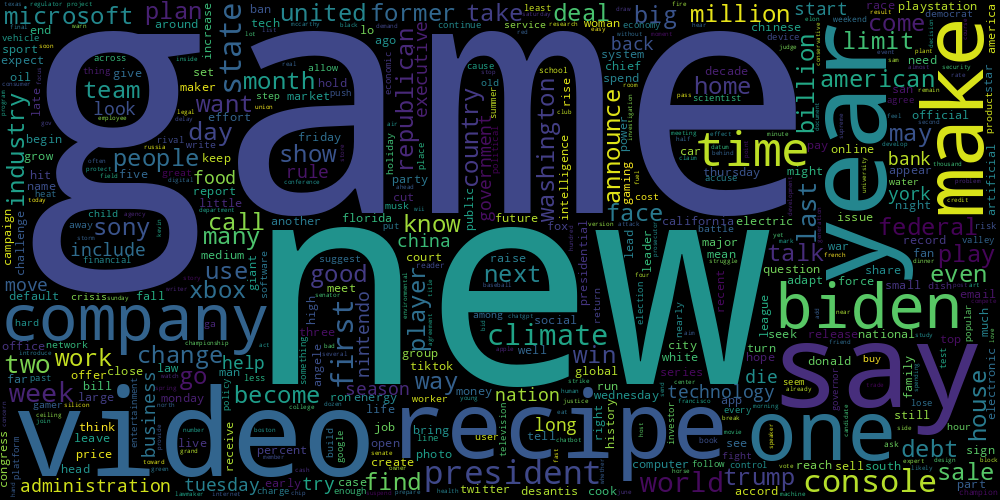

In [ ]:
from wordcloud import WordCloud

wordcloud = WordCloud(background_color='black', max_words=500,
                      width=1000, height=500, collocations=False)
wordcloud.generate(' '.join(list(preprocessed_texts)))
wordcloud.to_image() 

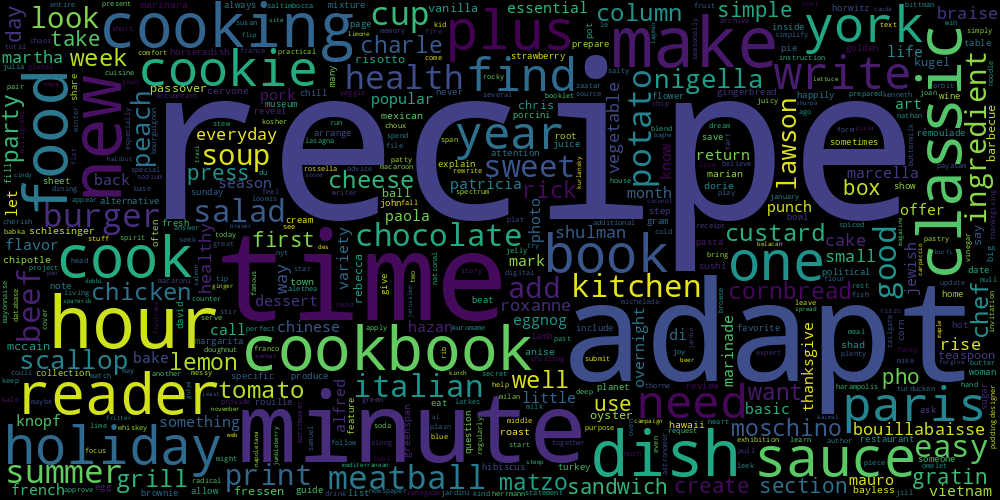

In [ ]:
def draw_cluster(cluster_idx, labels):
    assert cluster_idx < len(np.unique(labels))
    wordcloud.generate(' '.join(np.where(labels == cluster_idx, preprocessed_texts, '')))
    return wordcloud.to_image()
    
draw_cluster(0, labels)

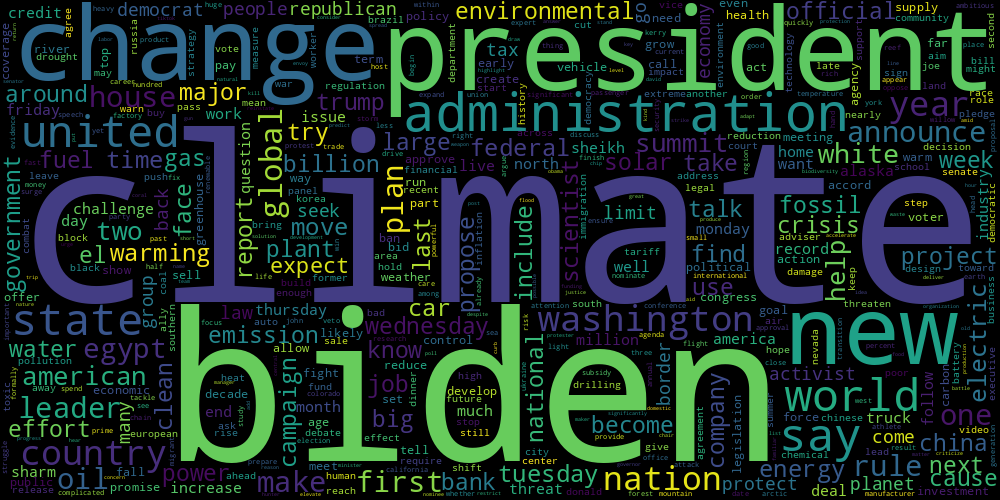

In [ ]:
draw_cluster(1, labels)

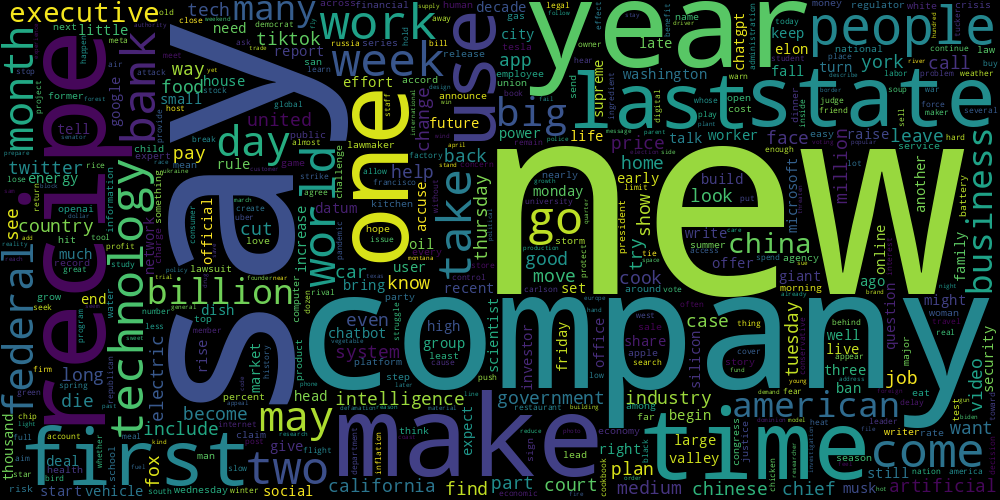

In [ ]:
draw_cluster(2, labels)

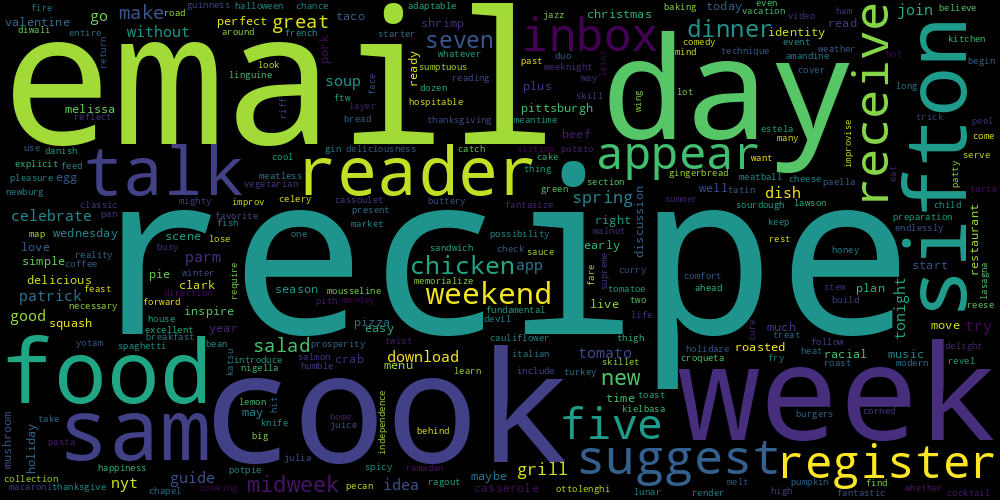

In [ ]:
draw_cluster(3, labels)

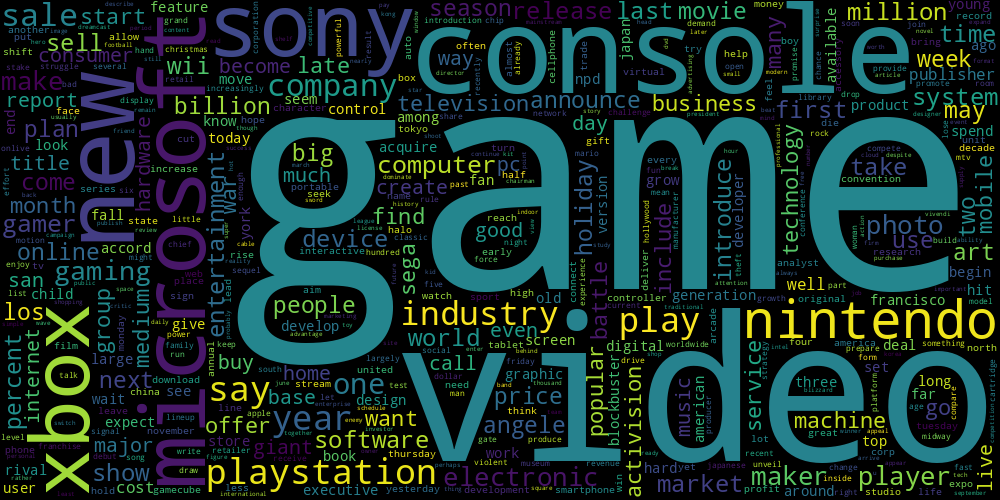

In [ ]:
draw_cluster(4, labels)

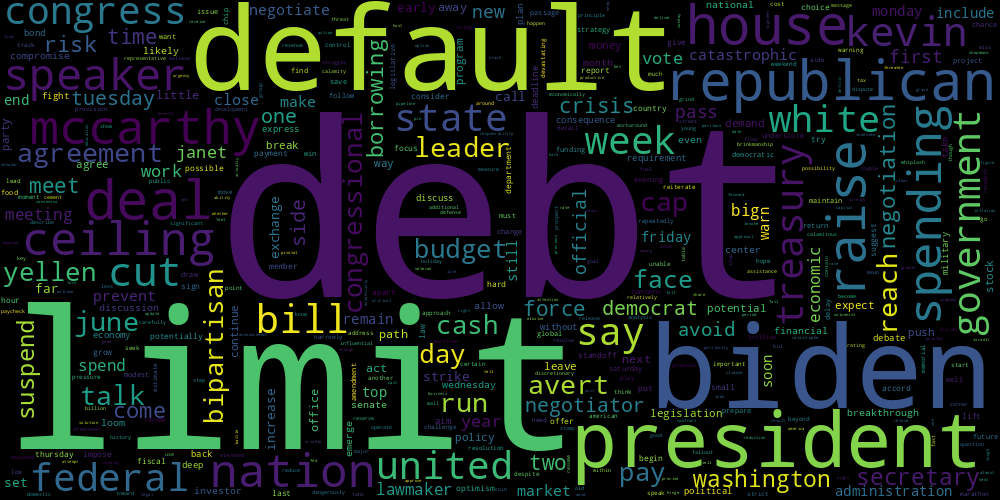

In [ ]:
draw_cluster(5, labels)

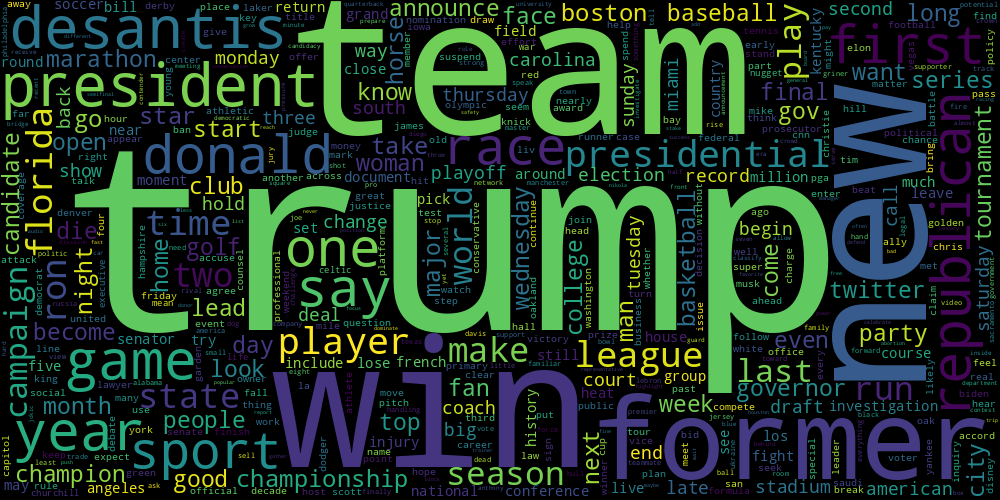

In [ ]:
draw_cluster(6, labels)

Изначально категории были следующими (мы не использовали их при кластеризации, список категорий не упорядоченный): 

* Business                    
* Climate and Environment     
* Politics                    
* Recipes                     
* Sports                      
* Technology                  
* Video Games and Consoles    

Какие категории получились в результате кластеризации? Посмотрим на облака слов! Почти во всех случаях темы можно выделить вполне однозначно:

* 0 кластер: Recipes
* 1 кластер: Climate and Environment
* 2 кластер: Business
* 3 кластер: Шумовой кластер: в него попали отрывки с маленькой длиной abstract или lead paragraph, для которых направленность определить сложно
* 4 кластер: Video Games and Consoles
* 5 кластер: Politics
* 6 кластер: Sports (но почему-то в него вмешались политики из республиканской партии)

Получаем, что наша модель может, пусть и с некоторой погрешностью, разделять тексты (новостные статьи, но можно экстраполировать работу и на другие тексты) на категории.

Подумаем, могла ли наша модель что-то упустить. На этапе препроцессинга мы избавляемся от пунктуации и всех слов, не принадлежащих алфавиту (не проходящих проверку на <code>isalpha</code>). Могли ли мы потерять некоторую важную информацию их текстов? Напишем регулярное выражение, чтобы это проверить: будем выделять только последовательности (отделенные пробелами), в которых есть и буквы, и цифры.

Как будет работать наше регулярное выражение:

* <code>\b</code> - Граница слова.
* <code>(?=\w*\d)</code> - Положительное условие. Требуется, чтобы последовательность содержала хотя бы одну цифру.
* <code>(?=\w*[a-zA-Z])</code> - Положительное условие. Требуется, чтобы последовательность содержала хотя бы одну букву (в любом регистре).
* <code>\w+</code> - Один или более символов слова (буквы, цифры или подчеркивания).
* <code>\b</code> - Граница слова.

Паттерн <code>\b(?=\w*\d)(?=\w*[a-zA-Z])\w+\b</code> находит только последовательности, которые содержат и буквы, и цифры, при условии, что они ограничены пробелами или границами слов. 

In [ ]:
import re

for text in texts:
    pattern = r"\b(?=\w*\d)(?=\w*[a-zA-Z])\w+\b"
    matches = re.findall(pattern, text)
    if len(matches) > 0:
        print(matches)

['Lemon8']
['1980s']
['HF0', 'HF0', '20s']
['7A']
['20s']
['19th']
['21st']
['1970s']
['3PO', 'R2', 'D2']
['1990s']
['1990s']
['VO2max']
['70s']
['1970s']
['1960s']
['40s']
['1970s']
['2nd']
['19th']
['M3GAN', 'M3GAN']
['1960s']
['11th']
['Deitche256']
['1A']
['1950s']
['41st']
['20Beauty', '20Fashion', '20Cookbook_722']
['A14']
['CO2']
['graphics8']
['1980s']
['1A']
['1980s']
['2pounds']
['Food52']
['1980s']
['E3']
['1980s', '2000s']
['19th']
['3D']
['PS4']
['E3', 'E3']
['19th', '19th']
['E3']
['E3', 'E3', 'E3']
['60th']
['MP3']
['E3', 'E3']
['E3', 'E3', 'E3']
['1990s']
['90s']
['1930s', '1960s']
['1990s', '1990s']
['E3', 'E3', 'E3']
['1980s']
['11th', '11th']
['E3']
['Plyr1', 'Plyr2', 'PS3']
['3D']
['E3', 'E3', 'E3']
['PlayStation2', 'PlayStation2', 'PlayStation2', 'PlayStation2']
['WET11']
['E3', 'E3', 'E3', 'E3']
['E3', 'E3']
['PlayStation2', 'PlayStation2', 'PlayStation2']
['90s']
['MP3']
['E3']
['ESPN3']
['PlayStation2', 'PlayStation2']
['20th']
['E3']
['E3', 'E3']
['4K']
['PlayS

Помимо очевидных слов, подходящих под паттерн (1960s, 2nd, 40s и др.), обнаружились и более интересные экземпляры. Например, в текстах про технологии и видео игры часто встречается слово PlayStation2 (при обычном препроцессинге оно обрезалось до PlayStation), а так же сокращённое название самой крупной игровой конференции – E3. Несмотря на то, что это слово достаточно частотное, и при этом важное для одной конкретной темы, мы упустили его при обычном препроцессинге. Ещё из находок можно отметить HTML5, DVD560, MP3 – слова, способные послужить маркерами текстов про технологии, а также COP27 – сокращённое название Конференции Организации Объединенных Наций по изменению климата 2022 года – тоже достаточно показательная аббревиатура. Мы потеряли не очень много информации, но, всё-таки, при грамотном использовании регулярных выражений мы могли её не потерять – совет на будущее для тех, кто занимается обработкой естественного языка.